In [ ]:
# !pip install missingno

In [1]:
# !pip install geopy

In [1]:
import pandas as pd
import pickle
import missingno as msno
import matplotlib.pyplot as plt 

In [2]:
from scipy import stats
import geopy
from geopy.geocoders import Nominatim

In [3]:
import numpy as np

In [4]:
RS = 42

# Final work

<b> Что нужно сделать </b> 

1. Проведите подготовительную работу (один час):
* Прочитайте предоставленный датасет.
* Ознакомьтесь с описаниями представленных атрибутов.
* Оцените полноту и чистоту данных. Попытайтесь понять, что стоит за этими данными в реальном мире. Приведите данные в удобный/нормальный вид для дальнейшей работы. 

2. Проведите разведочный анализ данных (четыре часа):
* Проведите базовую чистку: дубликаты, пустые значения, типизация данных, ненужные атрибуты.
* Посмотрите на распределение ключевых атрибутов, их отношения.

3. Выполните задание согласно вашей специализации (18 часов):
* Научитесь предсказывать совершение целевого действия (ориентировочное значение ROC-AUC ~ 0.65) — факт совершения пользователем целевого действия.
* Упакуйте получившуюся модель в сервис, который будет брать на вход все атрибуты, типа utm_*, device_*, geo_*, и отдавать на выход 0/1 (1 — если пользователь совершит любое целевое действие).

# EDA

## Load data and view

In [430]:
# Загрузка данных по сессиям
with open('data/ga_sessions.pkl', 'rb') as file:
    sessions = pickle.load(file)

In [6]:
sessions

,session_id,client_id,visit_date,visit_time,visit_number,utm_source,utm_medium,utm_campaign,utm_adcontent,utm_keyword,device_category,device_os,device_brand,device_model,device_screen_resolution,device_browser,geo_country,geo_city
0,9055434745589932991.1637753792.1637753792,2108382700.1637753791,2021-11-24,14:36:32,1,ZpYIoDJMcFzVoPFsHGJL,banner,LEoPHuyFvzoNfnzGgfcd,vCIpmpaGBnIQhyYNkXqp,puhZPIYqKXeFPaUviSjo,mobile,Android,Huawei,NaN,360x720,Chrome,Russia,Zlatoust
1,905544597018549464.1636867290.1636867290,210838531.1636867288,2021-11-14,08:21:30,1,MvfHsxITijuriZxsqZqt,cpm,FTjNLDyTrXaWYgZymFkV,xhoenQgDQsgfEPYNPwKO,IGUCNvHlhfHpROGclCit,mobile,Android,Samsung,NaN,385x854,Samsung Internet,Russia,Moscow
2,9055446045651783499.1640648526.1640648526,2108385331.1640648523,2021-12-28,02:42:06,1,ZpYIoDJMcFzVoPFsHGJL,banner,LEoPHuyFvzoNfnzGgfcd,vCIpmpaGBnIQhyYNkXqp,puhZPIYqKXeFPaUviSjo,mobile,Android,Huawei,NaN,360x720,Chrome,Russia,Krasnoyarsk
3,9055447046360770272.1622255328.1622255328,2108385564.1622255328,2021-05-29,05:00:00,1,kjsLglQLzykiRbcDiGcD,cpc,NaN,NOBKLgtuvqYWkXQHeYWM,NaN,mobile,None,Xiaomi,NaN,393x786,Chrome,Russia,Moscow
4,9055447046360770272.1622255345.1622255345,2108385564.1622255328,2021-05-29,05:00:00,2,kjsLglQLzykiRbcDiGcD,cpc,NaN,NaN,NaN,mobile,None,Xiaomi,NaN,393x786,Chrome,Russia,Moscow
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1860037,9055415581448263752.1640159305.1640159305,2108378238.1640159304,2021-12-22,10:48:25,1,BHcvLfOaCWvWTykYqHVe,cpc,NaN,NaN,VlqBmecIOXWjCWUmQkLd,desktop,Windows,None,NaN,1920x1080,Chrome,Russia,Moscow
1860038,9055421130527858185.1622007305.1622007305,2108379530.1622007305,2021-05-26,08:00:00,1,fDLlAcSmythWSCVMvqvL,(none),LTuZkdKfxRGVceoWkVyg,JNHcPlZPxEMWDnRiyoBf,NaN,mobile,None,Apple,NaN,390x844,Safari,Russia,Stavropol
1860039,9055422955903931195.1636979515.1636979515,2108379955.1636979515,2021-11-15,15:31:55,1,fDLlAcSmythWSCVMvqvL,(none),LTuZkdKfxRGVceoWkVyg,JNHcPlZPxEMWDnRiyoBf,puhZPIYqKXeFPaUviSjo,mobile,iOS,Apple,NaN,375x667,Safari,Russia,Moscow
1860040,905543020766873816.1638189404.1638189404,210838164.1638189272,2021-11-29,15:36:44,1,ZpYIoDJMcFzVoPFsHGJL,banner,LEoPHuyFvzoNfnzGgfcd,JNHcPlZPxEMWDnRiyoBf,puhZPIYqKXeFPaUviSjo,mobile,Android,Xiaomi,NaN,393x851,Chrome,Russia,Chelyabinsk


In [7]:
sessions.columns

Index(['session_id', 'client_id', 'visit_date', 'visit_time', 'visit_number',
       'utm_source', 'utm_medium', 'utm_campaign', 'utm_adcontent',
       'utm_keyword', 'device_category', 'device_os', 'device_brand',
       'device_model', 'device_screen_resolution', 'device_browser',
       'geo_country', 'geo_city'],
      dtype='object')

<Axes: >

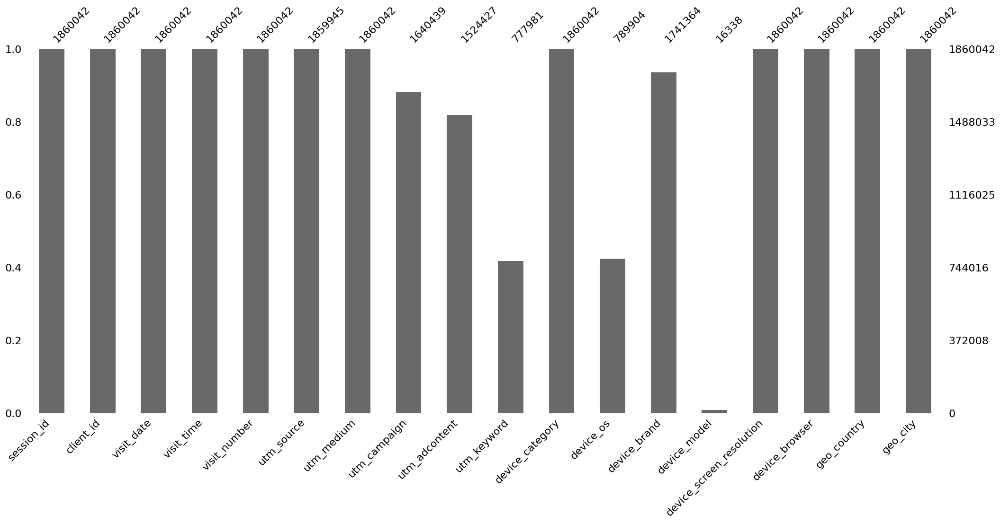

In [8]:
msno.bar(sessions)

In [278]:
sessions.duplicated().sum()

0

In [431]:
feature_list = ['utm_source', 'utm_medium', 'utm_campaign', 'utm_adcontent',
       'utm_keyword', 'device_category', 'device_os', 'device_brand',
       'device_model', 'device_screen_resolution', 'device_browser',
       'geo_country', 'geo_city']

In [280]:
sessions[feature_list].duplicated().sum()

1443220

In [12]:
# Загрузка данных по действиям
with open('data/ga_hits.pkl', 'rb') as file:
    ga_hits = pickle.load(file)

In [13]:
ga_hits

,session_id,hit_date,hit_time,hit_number,hit_type,hit_referer,hit_page_path,event_category,event_action,event_label,event_value
0,5639623078712724064.1640254056.1640254056,2021-12-23,597864.0,30,event,NaN,sberauto.com/cars?utm_source_initial=google&ut...,quiz,quiz_show,NaN,None
1,7750352294969115059.1640271109.1640271109,2021-12-23,597331.0,41,event,NaN,sberauto.com/cars/fiat?city=1&city=18&rental_c...,quiz,quiz_show,NaN,None
2,885342191847998240.1640235807.1640235807,2021-12-23,796252.0,49,event,NaN,sberauto.com/cars/all/volkswagen/polo/e994838f...,quiz,quiz_show,NaN,None
3,142526202120934167.1640211014.1640211014,2021-12-23,934292.0,46,event,NaN,sberauto.com/cars?utm_source_initial=yandex&ut...,quiz,quiz_show,NaN,None
4,3450086108837475701.1640265078.1640265078,2021-12-23,768741.0,79,event,NaN,sberauto.com/cars/all/mercedes-benz/cla-klasse...,quiz,quiz_show,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...
15726465,6866159858916559617.1640270865.1640270865,2021-12-23,810589.0,43,event,NaN,sberauto.com/cars/all/toyota/fortuner/24cb5af2...,quiz,quiz_show,NaN,None
15726466,7310304587364460692.1640261783.1640261783,2021-12-23,904927.0,40,event,NaN,sberauto.com/cars/all/mercedes-benz/gla-klasse...,quiz,quiz_show,NaN,None
15726467,8013702685784312179.1640270195.1640270195,2021-12-23,2172865.0,43,event,NaN,sberauto.com/cars/all/toyota/alphard/2ebe4871?...,quiz,quiz_show,NaN,None
15726468,8021505554734405918.1640257821.1640257821,2021-12-23,713325.0,45,event,NaN,sberauto.com/cars/all/bmw/x3/6a660f0a?rental_p...,quiz,quiz_show,NaN,None


In [14]:
ga_hits.columns

Index(['session_id', 'hit_date', 'hit_time', 'hit_number', 'hit_type',
       'hit_referer', 'hit_page_path', 'event_category', 'event_action',
       'event_label', 'event_value'],
      dtype='object')

<Axes: >

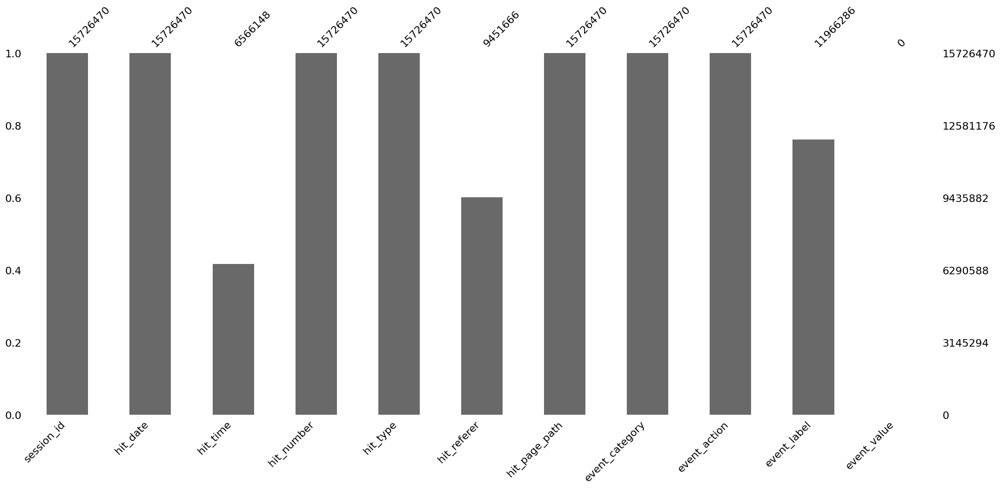

In [15]:
msno.bar(ga_hits)

In [16]:
ga_hits.duplicated().sum()

0

Согласно условию задания сервис должен принимать "на вход все атрибуты, типа utm_*, device_*, geo_* ". Поэтому из таблицы ga_hits буду использовать только значения целевой переменной. Хотя возможно и можно использовать другие параметры для улучшения предсказательной способности модели.

Целевое действие — события типа «Оставить заявку» и «Заказать звонок»
(ga_hits.event_action in ['sub_car_claim_click', 'sub_car_claim_submit_click',
'sub_open_dialog_click', 'sub_custom_question_submit_click',
'sub_call_number_click', 'sub_callback_submit_click', 'sub_submit_success',
'sub_car_request_submit_click']).

In [281]:
cr_list = ['sub_car_claim_click', 'sub_car_claim_submit_click', 'sub_open_dialog_click', 
 'sub_custom_question_submit_click', 'sub_call_number_click', 'sub_callback_submit_click', 
 'sub_submit_success', 'sub_car_request_submit_click']

In [282]:
ga_hits['conversion'] = ga_hits.event_action.apply(lambda x: x in cr_list)

In [283]:
ga_hits['conversion'].value_counts()

conversion
False    15621562
True       104908
Name: count, dtype: int64

In [284]:
ga_hits['conversion'].sum()/ga_hits['conversion'].shape[0]

0.006670791347327149

In [432]:
%%time
data = ga_hits.groupby(['session_id']).agg({'conversion': 'max'})
data

CPU times: total: 14.2 s
Wall time: 27.8 s


,conversion
session_id,
1000009318903347362.1632663668.1632663668,False
1000010177899156286.1635013443.1635013443,False
1000013386240115915.1635402956.1635402956,False
1000017303238376207.1623489300.1623489300,False
1000020580299877109.1624943350.1624943350,False
...,...
999960188766601545.1626816843.1626816843,False
99996598443387715.1626811203.1626811203,False
999966717128502952.1638428330.1638428330,False


In [433]:
sessions = sessions.merge(data, on='session_id', how='inner')

<Axes: >

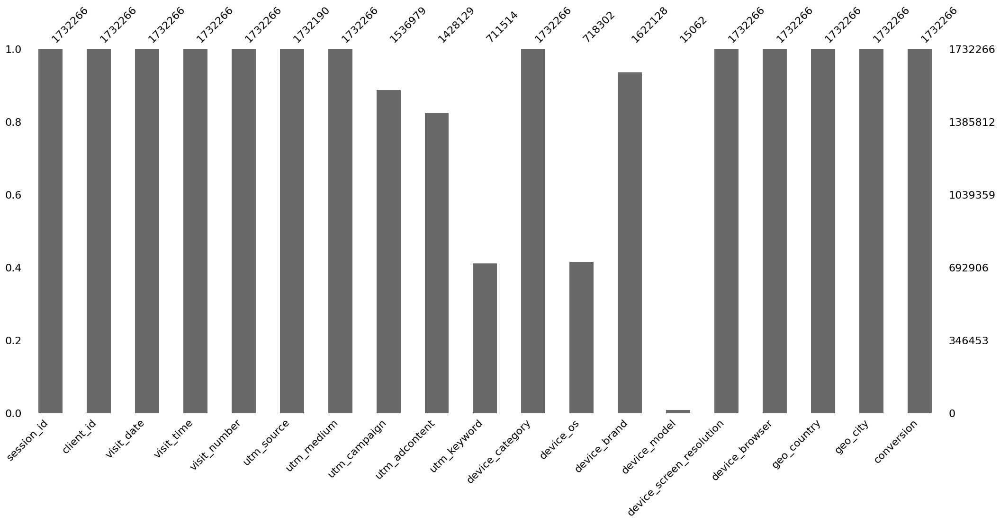

In [23]:
msno.bar(sessions)

In [24]:
sessions.conversion.value_counts()

conversion
False    1681952
True       50314
Name: count, dtype: int64

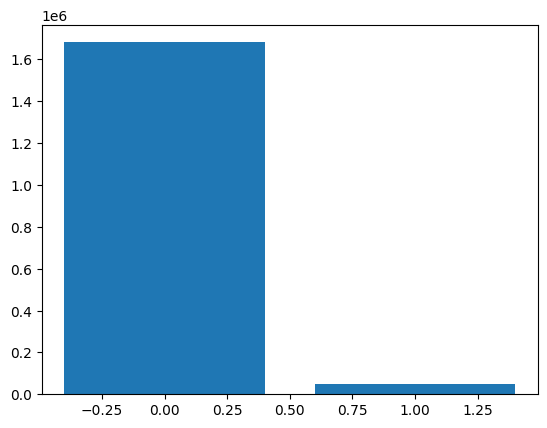

In [25]:
plt.bar([0, 1], sessions.conversion.value_counts())
plt.show()

In [434]:
sessions['target'] = sessions.conversion.apply(lambda x: int(x))

In [27]:
sessions.duplicated().sum()

0

In [435]:
use_list = feature_list.copy()

use_list.append('target')

use_list

['utm_source',
 'utm_medium',
 'utm_campaign',
 'utm_adcontent',
 'utm_keyword',
 'device_category',
 'device_os',
 'device_brand',
 'device_model',
 'device_screen_resolution',
 'device_browser',
 'geo_country',
 'geo_city',
 'target']

In [289]:
sessions[use_list].duplicated().sum()

1319574

In [30]:
# use_list.append('client_id')

In [31]:
# sessions[use_list].duplicated().sum()

In [436]:
sessions = sessions[use_list].drop_duplicates()

In [437]:
sessions[use_list].duplicated().sum()

0

In [292]:
# use_list = feature_list.copy()
# use_list.append('target')
# use_list

In [293]:
sessions.target.value_counts()

target
0    388251
1     24441
Name: count, dtype: int64

In [294]:
# sessions = sessions[use_list].drop_duplicates()

In [295]:
# sessions.target.value_counts()

In [296]:
sessions.columns

Index(['utm_source', 'utm_medium', 'utm_campaign', 'utm_adcontent',
       'utm_keyword', 'device_category', 'device_os', 'device_brand',
       'device_model', 'device_screen_resolution', 'device_browser',
       'geo_country', 'geo_city', 'target'],
      dtype='object')

In [198]:
# df_2 = sessions[use_list].copy()

In [199]:
# df_2 = df_2.drop_duplicates()

In [53]:
# plt.hist(df_2.target)
# plt.show()

## Анализ колонок

In [201]:
# в старой версии
# sessions = df_2.copy()

In [40]:
sessions.columns

Index(['utm_source', 'utm_medium', 'utm_campaign', 'utm_adcontent',
       'utm_keyword', 'device_category', 'device_os', 'device_brand',
       'device_model', 'device_screen_resolution', 'device_browser',
       'geo_country', 'geo_city', 'target'],
      dtype='object')

In [41]:
# функция для обобщения признаков без целевого действия
def decrease_unconv(in_series, target_series):
    series = in_series.fillna('other')
    on_conv_set = set(series[target_series==1].to_list())
    return series.apply(lambda x: x if x in on_conv_set else 'out')


In [42]:

def category_increase_by_bound(data_series, bound=30):
    values_dic = {}
    for v, c in zip(data_series.value_counts().index, data_series.value_counts()):
        values_dic[v] = c
    return data_series.apply(lambda x: x if values_dic[x] > 30 else 'bounded' )

### 'utm_source' — канал привлечения

Реклама в социальных сетях — все визиты с ga_sessions.utm_source in
('QxAxdyPLuQMEcrdZWdWb', 'MvfHsxITijuriZxsqZqt', 'ISrKoXQCxqqYvAZICvjs', 'IZEXUFLARCUMynmHNBGo', 'PlbkrSYoHuZBWfYjYnfw',
'gVRrcxiDQubJiljoTbGm').

In [297]:
sessions.utm_source.value_counts(dropna=False)

utm_source
ZpYIoDJMcFzVoPFsHGJL    94757
kjsLglQLzykiRbcDiGcD    69171
MvfHsxITijuriZxsqZqt    50438
fDLlAcSmythWSCVMvqvL    41247
bByPQxmDaMXgpHeypKSM    33735
                        ...  
VdeFdoGCqZBxFfKSHNLl        1
DBLWVjTjVZuzWYWTaDfZ        1
DWvtKQncdpXXfLBjBmGj        1
ZsHOHNXkbhgIDlKNiFMf        1
ShCnUddaAbEvEVCCZyOt        1
Name: count, Length: 281, dtype: int64

In [438]:
sessions.utm_source.isna().sum()

39

In [439]:
sessions.utm_source = sessions.utm_source.fillna('other')

In [440]:
# Делаем признак канала привлечения только как "Реклама в социальных сетях"

sessions.utm_source = sessions.utm_source.apply(lambda x: 1 if x in ('QxAxdyPLuQMEcrdZWdWb', 'MvfHsxITijuriZxsqZqt', 'ISrKoXQCxqqYvAZICvjs', 'IZEXUFLARCUMynmHNBGo', 
                        'PlbkrSYoHuZBWfYjYnfw', 'gVRrcxiDQubJiljoTbGm') else 0)

In [301]:
# category_increase_by_bound('utm_source', bound=100)

# decrease_unconv('utm_source')

# # Заполним пустые значения
# columns_to_fill_other.append('utm_source')

# sessions[columns_to_fill_other[5]] = sessions[columns_to_fill_other[5]].fillna('other')

In [302]:
sessions.utm_source.value_counts()

utm_source
0    338881
1     73811
Name: count, dtype: int64

In [303]:
sessions.utm_source.isna().sum()

0

### 'utm_medium' —  тип привлечения

In [304]:
sessions.utm_medium.value_counts()

utm_medium
cpc                  120077
banner                92934
cpm                   61900
referral              48203
(none)                41247
organic               12834
email                 10051
blogger_channel        4701
push                   4172
stories                3716
blogger_stories        2194
cpv                    2056
smartbanner            1782
tg                     1655
cpa                    1238
post                    710
smm                     521
blogger_header          520
outlook                 490
app                     457
clicks                  440
(not set)               233
info_text               164
sms                     116
partner                  74
landing                  36
vk_smm                   22
yandex_cpc               21
cbaafe                   21
static                   16
link                     12
google_cpc               10
article                  10
web_polka                 8
fb_smm                    8
CPM      

In [305]:
sessions.utm_medium.isna().sum()

0

In [441]:
# Тим привлечения делаем как "Органический трафик"

sessions.utm_medium = sessions.utm_medium.apply(lambda x: 1 if x in ('organic', 'referral', '(none)') else 0)

In [307]:
# # category_increase_by_bound('utm_medium', bound=300)
# decrease_unconv('utm_medium')

In [308]:
sessions.utm_medium.value_counts()

utm_medium
0    310408
1    102284
Name: count, dtype: int64

### 'utm_campaign' — рекламная кампания

In [309]:
sessions.utm_campaign.value_counts(dropna=False)

utm_campaign
LTuZkdKfxRGVceoWkVyg    82693
FTjNLDyTrXaWYgZymFkV    64235
LEoPHuyFvzoNfnzGgfcd    46131
NaN                     44520
gecBYcKZCPMcVYdSSzKP    24838
                        ...  
cqgnjDbqrtCipVvzhxqa        1
AdtHYglxfCpTpwZeTAuW        1
eYRDXZIocNyHVjEHzesr        1
qPDTdivQVeflLjTYIJnG        1
cXxuwXPoQCvAXPHpFcZl        1
Name: count, Length: 407, dtype: int64

In [310]:
sessions.utm_campaign.isna().sum()

44520

In [442]:
sessions.utm_campaign = decrease_unconv(sessions.utm_campaign, sessions.target)

In [60]:
sessions.utm_campaign = category_increase_by_bound(sessions.utm_campaign, bound=30)

In [312]:
sessions.utm_campaign.value_counts()

utm_campaign
LTuZkdKfxRGVceoWkVyg    82693
FTjNLDyTrXaWYgZymFkV    64235
LEoPHuyFvzoNfnzGgfcd    46131
other                   44520
gecBYcKZCPMcVYdSSzKP    24838
                        ...  
jUuukNIbGoOYdGYzBthG        3
CqFuKxSYgtGbcafqJwij        2
SbYAsCvXapXBOIxEKBZs        2
JkhCpeDGCtTwhwqWLywv        1
MHdHrBKQwbDaRalwnlJq        1
Name: count, Length: 225, dtype: int64

In [91]:
# sessions.utm_campaign = non_zero_user_transform('utm_campaign')

In [92]:
# decrease_unconv('utm_campaign')

In [93]:
# category_increase_by_bound('utm_campaign', bound=200)

In [94]:
# # Заполним пустые значения
# columns_to_fill_other.append('utm_campaign')

# sessions[columns_to_fill_other[4]] = sessions[columns_to_fill_other[4]].fillna('other')

In [313]:
sessions.utm_campaign.isna().sum()

0

### 'utm_adcontent' 

In [314]:
sessions.utm_adcontent.value_counts()

utm_adcontent
JNHcPlZPxEMWDnRiyoBf    213669
xhoenQgDQsgfEPYNPwKO     35541
vCIpmpaGBnIQhyYNkXqp     23149
PkybGvWbaqORmxjNunqZ     10548
LLfCasrxQzJIyuldcuWy      4418
                         ...  
cnqeKMAxlNzlImHJTOns         1
fiImkyBmzQSeAeQEVCDZ         1
uUDFLZnWKzkthhRGUTvb         1
vXARZToVDdvNhALiQtvl         1
oJivRDNIrrOckRBIKOtG         1
Name: count, Length: 280, dtype: int64

In [443]:
# sessions.utm_adcontent = non_zero_user_transform('utm_adcontent')
sessions.utm_adcontent = decrease_unconv(sessions.utm_adcontent, sessions.target)

In [66]:
sessions.utm_adcontent = category_increase_by_bound(sessions.utm_adcontent, bound=30)

In [316]:
sessions.utm_adcontent.value_counts()

utm_adcontent
JNHcPlZPxEMWDnRiyoBf    213669
other                    78796
xhoenQgDQsgfEPYNPwKO     35541
vCIpmpaGBnIQhyYNkXqp     23149
PkybGvWbaqORmxjNunqZ     10548
                         ...  
NnaLweGiAhdtkuktFipk         4
TxYGPZoJvwkuNUkpHgpP         4
isYoUwVPnRHJczHiHQbB         3
MGatbcZxAUUBKBwPWOkg         2
qHPyQVqWZtIwxZvzhkMv         2
Name: count, Length: 113, dtype: int64

In [317]:
# decrease_unconv('utm_adcontent')

# category_increase_by_bound('utm_adcontent', bound=100)

# sessions.utm_adcontent.value_counts()

# # Заполним пустые значения
# columns_to_fill_other.append('utm_adcontent')

# sessions[columns_to_fill_other[3]] = sessions[columns_to_fill_other[3]].fillna('other')

In [318]:
sessions.utm_adcontent.isna().sum()

0

### utm_keyword — ключевое слово

In [319]:
sessions.utm_keyword.value_counts(dropna=False)

utm_keyword
NaN                     210545
puhZPIYqKXeFPaUviSjo    105967
aXQzDWsJuGXeBXexNHjc      4425
ITfrGJNwVsHBGJMAKoct      3415
UKNBOHebRIIsQRsjNKay      3097
                         ...  
sLQbYFRIWJPmCqXsQgTS         1
iNaIAFVuZgYukekFQQbX         1
jiuZfEGBRodFnHKeFJbS         1
cqgnjDbqrtCipVvzhxqa         1
fcXWTQaKfxbkBkBnzLhK         1
Name: count, Length: 1193, dtype: int64

In [444]:
sessions.utm_keyword = decrease_unconv(sessions.utm_keyword, sessions.target)

In [72]:
sessions.utm_keyword = category_increase_by_bound(sessions.utm_keyword, bound=30)

In [321]:
sessions.utm_keyword.value_counts(dropna=False)

utm_keyword
other                   210545
puhZPIYqKXeFPaUviSjo    105967
out                      10813
aXQzDWsJuGXeBXexNHjc      4425
ITfrGJNwVsHBGJMAKoct      3415
                         ...  
MJEexgiyAbBxEZucRrxF         1
jWQZKvbKuDnnQLCqeuOF         1
ZsHOHNXkbhgIDlKNiFMf         1
KUROllwAYyecYcjFOgAi         1
WPZFTVRTmwVTvqqeSvcx         1
Name: count, Length: 380, dtype: int64

In [322]:
# decrease_unconv('utm_keyword')

In [323]:
sessions.utm_keyword.isna().sum()

0

### device_category — тип устройства

In [324]:
sessions.device_category.value_counts(dropna=False)

device_category
mobile     312362
desktop     89819
tablet      10511
Name: count, dtype: int64

In [325]:
sessions.device_category.isna().sum()

0

### device_os — ОС устройства

In [326]:
sessions.device_os.value_counts(dropna=False)

device_os
None             208165
Android          132107
iOS               32180
Windows           28681
Macintosh          9221
Linux              2194
(not set)            60
Chrome OS            51
BlackBerry           18
Tizen                 7
Firefox OS            2
Nokia                 2
Samsung               2
Windows Phone         2
Name: count, dtype: int64

In [445]:
# Заполним пустые значения значением other
columns_to_fill_other = ['device_os']
sessions[columns_to_fill_other[0]] = sessions[columns_to_fill_other[0]].fillna('other')


In [328]:
sessions.device_os.value_counts(dropna=False)

device_os
other            208165
Android          132107
iOS               32180
Windows           28681
Macintosh          9221
Linux              2194
(not set)            60
Chrome OS            51
BlackBerry           18
Tizen                 7
Firefox OS            2
Nokia                 2
Samsung               2
Windows Phone         2
Name: count, dtype: int64

In [329]:
sessions.device_os.isna().sum()

0

### device_brand — марка устройства

In [330]:
sessions.device_brand.value_counts(dropna=False)

device_brand
Samsung     81400
Apple       67657
Xiaomi      56959
            49799
Huawei      47016
            ...  
Jiayu           1
Tesla           1
Vodafone        1
Wexler          1
Maxvi           1
Name: count, Length: 202, dtype: int64

In [110]:
# sessions[sessions.device_brand.isna()].conversion.sum()

# sessions[sessions.device_brand.notna()].conversion.sum()

# sessions.device_brand.isna().sum()

# sessions[sessions.device_brand.isna()].conversion.sum()/sessions.device_brand.isna().sum()

# sessions[sessions.device_brand.notna()].conversion.sum()/sessions.device_brand.notna().sum()

# sessions[sessions.device_brand.isna()].conversion.sum()/sessions[sessions.device_brand.notna()].conversion.sum()

Отношение конверсии по незаполненным значениям поля device_brand значительно отличается от всего датасета. Пустые значения нужно заполнять. Заполним значением other.

In [111]:
# sessions['device_brand'] = sessions.device_brand.fillna('other')

In [446]:
sessions.device_brand = decrease_unconv(sessions.device_brand, sessions.target)

In [84]:
sessions.device_brand = category_increase_by_bound(sessions.device_brand, bound=30)

In [332]:
sessions.device_brand.value_counts()

device_brand
Samsung       81400
Apple         67657
Xiaomi        56959
              49799
Huawei        47016
              ...  
Condor            5
Razer             3
Vertu             3
Land Rover        2
Motive            1
Name: count, Length: 69, dtype: int64

In [333]:
sessions.device_brand.isna().sum()

0

### device_model — модель устройства

In [334]:
# Самая пустая колонка
sessions.device_model.value_counts(dropna=False)

device_model
NaN                     403192
AuMdmADEIoPXiWpTsBEj      5257
tWBQlsvNfHxRUjaPAfhd       321
cwMJxNXiWUgMUxGiCTPs       302
pTgAEPipQxDXCjPrJbHo       258
                         ...  
XnjPzKjkHmznVfULanbE         1
hOhIHYHnDhUlkzDoZJdA         1
zcovoWIWBZLooJXEJyTD         1
TMDlgkQzhHCgECHRtiOW         1
UBWdrePiTaaBAMHVHpOq         1
Name: count, Length: 105, dtype: int64

In [335]:
# sessions[sessions.device_model.isna()]['conversion'].sum()

# sessions[sessions.device_model.notna()]['conversion'].sum()

# sessions[sessions.device_model.notna()]['conversion'].sum()/sessions[sessions.device_model.isna()]['conversion'].sum()

# sessions[sessions.device_model.notna()]['conversion'].sum()/sessions.device_model.notna().sum()

# sessions[sessions.device_model.isna()]['conversion'].sum()/sessions.device_model.isna().sum()

Отношение конверсии не сильно зависит от наличия или отсутствия поля device_model, поэтому буду удалять это поле.

In [447]:
columns_to_drop = ['device_model']

In [448]:
sessions = sessions.drop(columns=columns_to_drop)

### device_screen_resolution — разрешение экрана

In [338]:
sessions.device_screen_resolution.value_counts(dropna=False)

device_screen_resolution
360x640      21155
360x800      20058
360x780      19944
1920x1080    19341
414x896      15651
             ...  
398x842          1
1536x792         1
406x879          1
450x768          1
464x1123         1
Name: count, Length: 4947, dtype: int64

In [449]:
# category_increase_by_bound('device_screen_resolution', bound=500)
# decrease_unconv('device_screen_resolution')
sessions.device_screen_resolution = decrease_unconv(sessions.device_screen_resolution, sessions.target)

In [92]:
sessions.device_screen_resolution = category_increase_by_bound(sessions.device_screen_resolution, bound=30)

In [340]:
sessions.device_screen_resolution.value_counts()

device_screen_resolution
360x640      21155
360x800      20058
360x780      19944
1920x1080    19341
out          16993
             ...  
1513x851         1
768x612          1
411x845          1
425x733          1
2550x1440        1
Name: count, Length: 494, dtype: int64

In [341]:
sessions.device_screen_resolution.isna().sum()

0

### device_browser — браузер

In [342]:
sessions.device_browser.value_counts(dropna=False)

device_browser
Chrome                              234581
Safari                               58156
YaBrowser                            44570
Android Webview                      22872
Samsung Internet                     15796
Opera                                11421
Safari (in-app)                      10799
Firefox                               7758
Edge                                  5485
UC Browser                             529
Android Runtime                        146
Mozilla Compatible Agent                83
[FBAN                                   73
MRCHROME                                66
Instagram 208.0.0.32.135 Android        40
Puffin                                  38
Android Browser                         35
Instagram 209.0.0.21.119 Android        30
Internet Explorer                       24
Opera Mini                              20
Maxthon                                 19
Android                                 17
Mozilla                                

In [450]:
sessions.device_browser = sessions.device_browser.apply(lambda x: 'Instagram' if x.split(' ')[0]=='Instagram' else x)

In [451]:
# category_increase_by_bound('device_browser', bound=10)
# decrease_unconv('device_browser')
sessions.device_browser = decrease_unconv(sessions.device_browser, sessions.target)

In [345]:
sessions.device_browser.value_counts()

device_browser
Chrome              234581
Safari               58156
YaBrowser            44570
Android Webview      22872
Samsung Internet     15796
Opera                11421
Safari (in-app)      10799
Firefox               7758
Edge                  5485
out                    594
UC Browser             529
MRCHROME                66
Puffin                  38
Maxthon                 19
com.vk.vkclient          8
Name: count, dtype: int64

In [346]:
sessions.device_browser.isna().sum()

0

### geo_country — страна

In [347]:
sessions.geo_country.value_counts(dropna=False)

geo_country
Russia                 380561
Ukraine                  5605
United States            4065
Belarus                  2051
Kazakhstan               1529
                        ...  
New Caledonia               1
Puerto Rico                 1
Yemen                       1
Rwanda                      1
Congo - Brazzaville         1
Name: count, Length: 159, dtype: int64

In [452]:
# sessions[sessions['geo_country']!='Russia'].conversion.sum()

# sessions[sessions['geo_country']=='Russia'].conversion.sum()

# category_increase_by_bound('geo_country', bound=100)
# decrease_unconv('geo_country')

# sessions[sessions['geo_country']=='zero_key'].geo_city.value_counts()

sessions.geo_country = decrease_unconv(sessions.geo_country, sessions.target)

In [102]:
sessions.geo_country = category_increase_by_bound(sessions.geo_country, bound=30)

In [349]:
sessions.geo_country.value_counts()

geo_country
Russia           380561
Ukraine            5605
United States      4065
Belarus            2051
Kazakhstan         1529
                  ...  
Afghanistan          21
Pakistan             20
Nigeria              20
Philippines          16
Iceland              11
Name: count, Length: 76, dtype: int64

### geo_city — город

In [350]:
sessions.geo_city.value_counts(dropna=False)

geo_city
Moscow              89335
Saint Petersburg    47697
(not set)           20192
Kazan                6542
Yekaterinburg        6504
                    ...  
Hoorn                   1
Schiedam                1
Nimes                   1
Kurakhove               1
Compiegne               1
Name: count, Length: 2389, dtype: int64

#### v1

In [105]:
sity_set = set(sessions.geo_city.value_counts().index)

In [106]:
sity_loc_dic = {}

In [107]:
%%time
locator = Nominatim(user_agent = "myapp")
for i in sity_set:
    sity_loc_dic[i] = locator.geocode(i)

CPU times: total: 9.2 s
Wall time: 19min 58s


In [351]:
sessions.geo_city.isna().sum()

0

In [352]:
temp_loc = sessions.geo_city.apply(lambda x: sity_loc_dic[x])

In [353]:
sessions['lat'] = temp_loc.apply(lambda x: x.latitude if x is not None else 0)

In [354]:
sessions['long'] = temp_loc.apply(lambda x: x.longitude if x is not None else 0)

#### v2

In [453]:
sessions.geo_city = decrease_unconv(sessions.geo_city, sessions.target)

In [355]:
sessions.geo_city.describe()

count     412692
unique      2389
top       Moscow
freq       89335
Name: geo_city, dtype: object

In [356]:
sessions['lat'].describe()

count    412692.000000
mean         48.023683
std          13.856049
min         -46.411847
25%          44.560945
50%          55.494191
75%          55.750446
max          69.537566
Name: lat, dtype: float64

<Axes: >

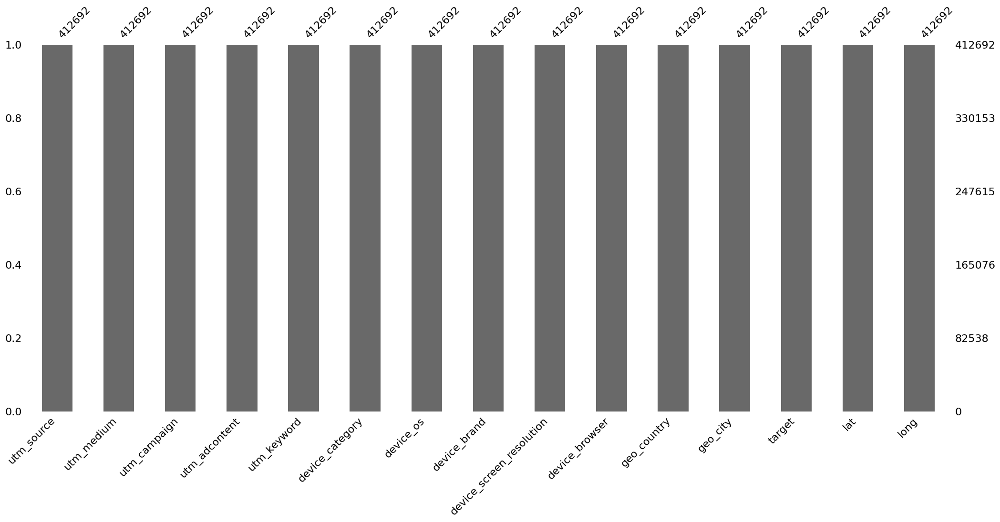

In [357]:
msno.bar(sessions)

In [358]:
sessions.columns

Index(['utm_source', 'utm_medium', 'utm_campaign', 'utm_adcontent',
       'utm_keyword', 'device_category', 'device_os', 'device_brand',
       'device_screen_resolution', 'device_browser', 'geo_country', 'geo_city',
       'target', 'lat', 'long'],
      dtype='object')

In [359]:
# V.1
columnst_to_transform = [ 'utm_source', 'utm_medium', 'utm_campaign', 'utm_adcontent',
       'utm_keyword', 'device_category', 'device_os', 'device_brand',
       'device_screen_resolution', 'device_browser', 'geo_country']

In [454]:
# V.2
columnst_to_transform = [ 'utm_source', 'utm_medium', 'utm_campaign', 'utm_adcontent',
       'utm_keyword', 'device_category', 'device_os', 'device_brand',
       'device_screen_resolution', 'device_browser', 'geo_country', 'geo_city']

In [455]:
sessions.duplicated().sum()

46758

In [456]:
sessions = sessions.drop_duplicates()

In [362]:
sessions.duplicated().sum()

0

<Axes: >

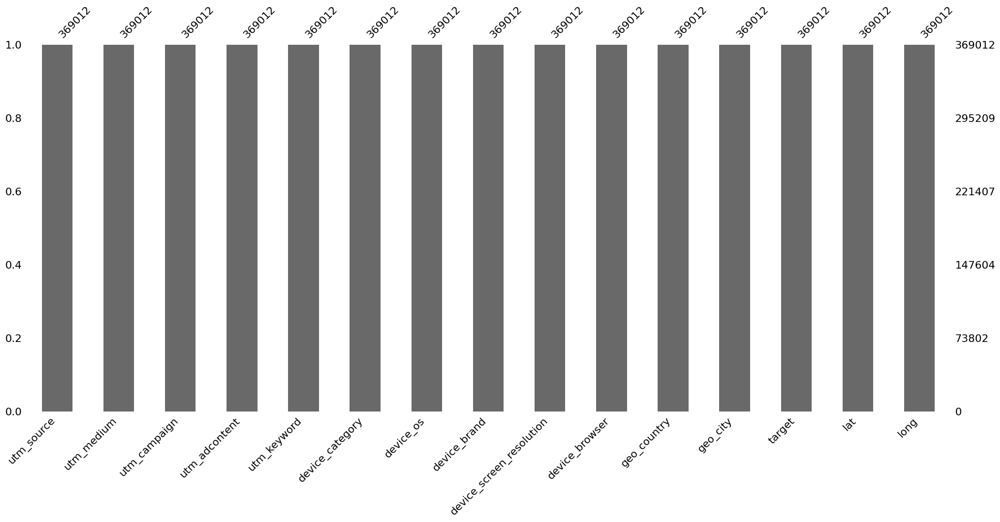

In [363]:
msno.bar(sessions)

In [168]:
# cols = columnst_to_transform.copy()

In [169]:
# cols.append('target')
# cols.append('lat')
# cols.append('long')
# cols

In [170]:
# sessions[cols]

In [171]:
# data = sessions[cols]

In [172]:
# data.duplicated().sum()

In [173]:
# data = data.drop_duplicates()

In [174]:
# data.target.value_counts()

In [175]:
# plt.bar([0, 1], data.target.value_counts())
# plt.show()

## Modelling

In [457]:
from sklearn.preprocessing import OneHotEncoder

In [458]:
ohe = OneHotEncoder(sparse=False)

In [459]:
columnst_to_transform

['utm_source',
 'utm_medium',
 'utm_campaign',
 'utm_adcontent',
 'utm_keyword',
 'device_category',
 'device_os',
 'device_brand',
 'device_screen_resolution',
 'device_browser',
 'geo_country',
 'geo_city']

In [460]:
ohe.fit(sessions[columnst_to_transform])

D:\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:828: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


OneHotEncoder(sparse=False, sparse_output=False)

In [461]:
ohe_names = ohe.get_feature_names_out()

In [462]:
ohe_names

array(['utm_source_0', 'utm_source_1', 'utm_medium_0', ...,
       'geo_city_out', 'geo_city_Тимофеевка', 'geo_city_Хомутово'],
      dtype=object)

In [463]:
len(ohe_names)

2025

In [464]:
ohe_data = ohe.transform(sessions[columnst_to_transform])

In [465]:
sessions[ohe_names] = ohe_data

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  sessions[ohe_names] = ohe_data
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_4364\3332513349.py:1: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at 

In [199]:
msno.bar(sessions)

<Axes: >

In [466]:
sessions = sessions.drop(columns=columnst_to_transform)

In [374]:
sessions = sessions.drop(columns='geo_city')

In [467]:
sessions.isna().sum().max()

0

In [213]:
msno.bar(sessions)

<Axes: >

In [187]:
# sessions.columns

In [376]:
columns_to_drop = ['session_id', 'client_id', 'visit_date', 'visit_time', 'visit_number',
       'utm_source', 'utm_medium', 'utm_campaign', 'utm_adcontent',
       'utm_keyword', 'device_category', 'device_os', 'device_brand',
       'device_screen_resolution', 'device_browser', 'geo_country', 'geo_city',
       'conversion']

In [188]:
# ndata = pd.DataFrame()

In [189]:
# ndata[ohe_names] = ohe_data.toarray()

In [135]:
# sessions = sessions.drop(columns=columns_to_drop)

In [190]:
# ndata['lat'] = sessions.lat
# ndata['long'] = sessions.long

In [191]:
# ndata.columns

In [192]:
# names_list = ohe_names.tolist()

In [193]:
# names_list.append('lat')
# names_list.append('long')

In [140]:
# %%time
# sessions.drop_duplicates(inplace=True)

In [194]:
# ndata.shape

In [195]:
# data.shape

In [196]:
# data['target'].value_counts()

In [197]:
# ndata['target'] = sessions.target

In [204]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier

In [205]:
from sklearn.metrics import accuracy_score

In [206]:
from sklearn.metrics import confusion_matrix

In [468]:
%%time
x_tr, x_test, y_tr, y_test = train_test_split(sessions.drop(columns='target'), sessions['target'], random_state=RS)

CPU times: total: 39.3 s
Wall time: 1min 18s


### Random Forest

In [494]:
rf_clf = RandomForestClassifier(class_weight='balanced',
                           random_state=RS)

In [495]:
%%time
rf_clf.fit(x_tr, y_tr)

CPU times: total: 10min 55s
Wall time: 10min 59s


RandomForestClassifier(class_weight='balanced', random_state=42)

In [496]:
y_pred = rf_clf.predict(x_test)

In [497]:
roc_auc_score(y_test, y_pred)

0.4832453681352902

In [498]:
accuracy_score(y_test, y_pred)

0.9049123343972717

In [499]:
confusion_matrix(y_test, y_pred)

array([[82762,  3243],
       [ 5456,    23]], dtype=int64)

In [500]:
test_proba = rf_clf.predict_proba(x_test)

In [510]:
test_num = list( 1 if x > 0.001 else 0 for x in test_proba[:,1] )

roc_auc_score(y_test, test_num)

0.5767513622763245

In [511]:
confusion_matrix(y_test, test_num)

array([[21082, 64923],
       [  502,  4977]], dtype=int64)

In [276]:
accuracy_score(y_test, test_num)

0.5639002977160614

### Neural Network

In [324]:
from sklearn.neural_network import MLPClassifier

In [325]:
mlp = MLPClassifier(random_state=42, hidden_layer_sizes=(2025, 512, 256), verbose=True)

In [326]:
%%time
mlp.fit(x_tr, y_tr)

Iteration 1, loss = 0.20411499
Iteration 2, loss = 0.19491433
Iteration 3, loss = 0.18889608
Iteration 4, loss = 0.18189109
Iteration 5, loss = 0.17152221
Iteration 6, loss = 0.15806504
Iteration 7, loss = 0.14435696
Iteration 8, loss = 0.13287290
Iteration 9, loss = 0.12341458
Iteration 10, loss = 0.11638096
Iteration 11, loss = 0.11065415
Iteration 12, loss = 0.10594051
Iteration 13, loss = 0.10259131
Iteration 14, loss = 0.09995632
Iteration 15, loss = 0.09719754
Iteration 16, loss = 0.09514269
Iteration 17, loss = 0.09292605
Iteration 18, loss = 0.09182104
Iteration 19, loss = 0.09070343
Iteration 20, loss = 0.08892553
Iteration 21, loss = 0.08815916
Iteration 22, loss = 0.08772391
Iteration 23, loss = 0.08683540
Iteration 24, loss = 0.08602928
Iteration 25, loss = 0.08548181
Iteration 26, loss = 0.08526660
Iteration 27, loss = 0.08415378
Iteration 28, loss = 0.08386445
Iteration 29, loss = 0.08358030
Iteration 30, loss = 0.08271177
Iteration 31, loss = 0.08284506
Iteration 32, los

MLPClassifier(hidden_layer_sizes=(2025, 512, 256), random_state=42,
              verbose=True)

In [327]:
y_pred_nn = mlp.predict(x_test)

In [328]:
y_pred_nn

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [329]:
roc_auc_score(y_test, y_pred_nn)

0.500557335687188

In [330]:
confusion_matrix(y_test, y_pred_nn)

array([[80858,  5147],
       [ 5145,   334]], dtype=int64)

In [331]:
test_proba_2 = mlp.predict_proba(x_test)

In [430]:
test_num_2 = list( 1 if x > 0.0000195 else 0 for x in test_proba_2[:,1] )
roc_auc_score(y_test, test_num_2)

0.661633391030558

In [431]:
confusion_matrix(y_test, test_num_2)

array([[52871, 33134],
       [ 1597,  3882]], dtype=int64)

In [432]:
accuracy_score(y_test, test_num_2)

0.6203598443443662

In [380]:
test_proba_2

array([[9.99981964e-01, 1.80362255e-05],
       [1.00000000e+00, 4.51692273e-11],
       [9.99917347e-01, 8.26532882e-05],
       ...,
       [9.99998669e-01, 1.33130884e-06],
       [9.94994784e-01, 5.00521649e-03],
       [9.99999872e-01, 1.27954543e-07]])

### Logistic Regression

In [217]:
from sklearn.linear_model import LogisticRegression

In [512]:
logreg = LogisticRegression(class_weight='balanced',
                           random_state=RS)

In [513]:
%%time
logreg.fit(x_tr, y_tr)

CPU times: total: 9min 18s
Wall time: 2min


D:\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(class_weight='balanced', random_state=42)

In [514]:
y_pred_lr = logreg.predict(x_test)
roc_auc_score(y_test, y_pred_lr)

0.7031377151285756

In [515]:
confusion_matrix(y_test, y_pred_lr)

array([[57530, 28475],
       [ 1439,  4040]], dtype=int64)

In [220]:
# old variant with bounding
y_pred_lr = logreg.predict(x_test)
roc_auc_score(y_test, y_pred_lr)

0.6554576585417281

In [222]:
confusion_matrix(y_test, y_pred_lr)

array([[55134, 31447],
       [ 1777,  3676]], dtype=int64)

In [516]:
test_proba_lr = logreg.predict_proba(x_test)

In [524]:
test_num_lr = list( 1 if x > 0.55 else 0 for x in test_proba_lr[:,1] )
roc_auc_score(y_test, test_num_lr)

0.7053473357252804

In [240]:
confusion_matrix(y_test, test_num_lr)

array([[55134, 31447],
       [ 1777,  3676]], dtype=int64)

In [241]:
accuracy_score(y_test, test_num_lr)

0.6390029771606146

In [469]:
logreg2 = LogisticRegression(random_state=RS)

In [470]:
%%time
logreg2.fit(x_tr, y_tr)

D:\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


CPU times: total: 8min 59s
Wall time: 2min 7s


LogisticRegression(random_state=42)

In [471]:
y_pred_lr2 = logreg2.predict(x_test)
roc_auc_score(y_test, y_pred_lr2)

0.5018373104642245

In [472]:
test_proba_lr2 = logreg2.predict_proba(x_test)

In [491]:
test_num_lr2 = list( 1 if x > 0.069 else 0 for x in test_proba_lr2[:,1] )
roc_auc_score(y_test, test_num_lr2)

0.7056057270065168

In [492]:
confusion_matrix(y_test, test_num_lr2)

array([[61455, 24550],
       [ 1662,  3817]], dtype=int64)

In [493]:
accuracy_score(y_test, test_num_lr2)

0.713479952778628

In [25]:
# Test library
from geopy.geocoders import Nominatim

locator = Nominatim(user_agent = "myapp")
location = locator.geocode("Ярославль")

print(location.latitude, location.longitude)
# 37.8303213 -122.4797496

print(location.point)
# 37 49m 49.1567s N, 122 28m 47.0986s W

print(type(location.point))
# <class 'geopy.point.Point'>

57.6263877 39.8933705
57 37m 34.9957s N, 39 53m 36.1338s E
<class 'geopy.point.Point'>
